# Debt Market Model

The purpose of this notebook is to configure and simulate the full CDP and APT system model, using a stochastic Ethereum price and liquidity demand process as a driver, under different PI controller settings - enabled, disabled, `kp` and `ki`.

# Setup and Dependencies

In [1]:
# Set project root folder, to enable importing project files from subdirectories
from pathlib import Path
import os

path = Path().resolve()
root_path = str(path).split('notebooks')[0]
os.chdir(root_path)

# Force reload of project modules, sometimes necessary for Jupyter kernel
%load_ext autoreload
%autoreload 2

# Display cadCAD version for easy debugging
%pip show cadCAD

Name: cadCAD
Version: 0.4.23
Summary: cadCAD: a differential games based simulation software package for research, validation, and         Computer Aided Design of economic systems
Home-page: https://github.com/cadCAD-org/cadCAD
Author: Joshua E. Jodesty
Author-email: joshua@block.science
License: LICENSE.txt
Location: /home/aclarkdata/repos/reflexer/venv/lib/python3.8/site-packages
Requires: pandas, fn, pathos, funcy
Required-by: cadCAD-machine-search
Note: you may need to restart the kernel to use updated packages.


In [2]:
# Import all shared dependencies and setup
from shared import *

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
# import plotly.io as pio
# pio.renderers.default = "png"

# Environmental Processes

In [3]:
# Import the ETH price stochastic dataset
from models.system_model_v3.model.params.init import eth_price_df

In [4]:
# Plot the ETH price for the first MC run dataset
eth_price_df['0'].plot()

# Model Configuration

In [5]:
from models.system_model_v3.model.state_variables.init import state_variables

state_variables.update({})

In [11]:
from models.system_model_v3.model.params.init import params


# Update the default parameter values
params_update = {
    'controller_enabled': [True],
    'kp': [2.000000e-07], # proportional term for the stability controller: units 1/USD
    'ki': [-5.000000e-09], # integral term for the stability controller: units 1/(USD*seconds)
}

params.update(params_update)


# Simulation Execution

In [12]:
# Set the number of simulation timesteps, with a maximum of `len(eth_price_df) - 1`
SIMULATION_TIMESTEPS = len(eth_price_df) - 1
SIMULATION_TIMESTEPS

8758

In [13]:
# Create a wrapper for the model simulation, and update the existing parameters and initial state
system_simulation = ConfigWrapper(system_model_v3, T=range(SIMULATION_TIMESTEPS), M=params, initial_state=state_variables)

In [14]:
del configs[:] # Clear any prior configs
(simulation_result, _tensor_field, _sessions) = run(system_simulation, drop_midsteps=False) # Run the simulation


                  ___________    ____
  ________ __ ___/ / ____/   |  / __ \
 / ___/ __` / __  / /   / /| | / / / /
/ /__/ /_/ / /_/ / /___/ ___ |/ /_/ /
\___/\__,_/\__,_/\____/_/  |_/_____/
by cadCAD

Execution Mode: local_proc
Configuration Count: 1
Dimensions of the first simulation: (Timesteps, Params, Runs, Vars) = (8758, 34, 1, 43)
Execution Method: local_simulations
SimIDs   : [0]
SubsetIDs: [0]
Ns       : [0]
ExpIDs   : [1]
Execution Mode: single_threaded
Total execution time: 4692.86s


# Simulation Analysis

In [15]:
# Add new columns to dataframe
simulation_result = simulation_result.assign(eth_collateral_value = simulation_result.eth_collateral * simulation_result.eth_price)
simulation_result['collateralization_ratio'] = (simulation_result.eth_collateral * simulation_result.eth_price) / (simulation_result.principal_debt * simulation_result.target_price)

# Update dataframe display settings
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 50)

simulation_result

,index,cdp_metrics,optimal_values,sim_metrics,timedelta,cumulative_time,timestamp,blockheight,eth_price,liquidity_demand,liquidity_demand_mean,cdps,eth_collateral,eth_locked,eth_freed,eth_bitten,principal_debt,rai_drawn,rai_wiped,rai_bitten,accrued_interest,interest_dripped,interest_wiped,interest_bitten,w_1,w_2,w_3,system_revenue,stability_fee,market_price,market_price_twap,target_price,target_rate,eth_return,eth_gross_return,expected_market_price,expected_debt_price,error_star,error_star_integral,market_slippage,RAI_balance,ETH_balance,UNI_supply,uniswap_oracle,simulation,subset,run,substep,timestep,events,eth_collateral_value,collateralization_ratio
0,0,{},{},{},0,0,2017-01-01 00:00:00,0,294.069151,1.000000,1.000000,None,154827.528922,154827.528922,0.00000,0.0,1.000000e+07,1.000000e+07,0.000000e+00,0.0,0.000000,0,0,0,0.000000e+00,0.0,0.0,0.0,1.585490e-10,3.140000,0.000000,3.140000,0.000000e+00,0.000000,0.0,3.140000,3.14,0.000000,0.000000,0.000000,1.000000e+07,106777.606153,1.000000e+07,None,0,0,1,0,0,NaN,4.553000e+07,1.450000
1,1,{},{},{},0,0,2017-01-01 00:00:00,0,294.069151,1.000000,1.000000,None,154827.528922,154827.528922,0.00000,0.0,1.000000e+07,1.000000e+07,0.000000e+00,0.0,0.000000,0,0,0,0.000000e+00,0.0,0.0,0.0,1.585490e-10,3.140000,0.000000,2.165517,0.000000e+00,0.000000,0.0,3.140000,3.14,0.000000,0.000000,0.000000,1.000000e+07,106777.606153,1.000000e+07,None,0,0,1,1,1,NaN,4.553000e+07,2.102500
2,2,{},{},{},3600,3600,2017-01-01 01:00:00,0,294.069151,1.000000,1.000000,None,154827.528922,154827.528922,0.00000,0.0,1.000000e+07,1.000000e+07,0.000000e+00,0.0,0.000000,0,0,0,0.000000e+00,0.0,0.0,0.0,1.585490e-10,3.140000,0.000000,2.165517,0.000000e+00,0.000000,0.0,3.140000,3.14,0.000000,0.000000,0.000000,1.000000e+07,106777.606153,1.000000e+07,None,0,0,1,2,1,NaN,4.553000e+07,2.102500
3,3,{},{},{},3600,3600,2017-01-01 01:00:00,0,294.069151,906.674484,453.837242,None,154827.528922,154827.528922,0.00000,0.0,1.000000e+07,1.000000e+07,0.000000e+00,0.0,0.000000,0,0,0,0.000000e+00,0.0,0.0,0.0,1.585490e-10,3.140000,0.000000,2.165517,0.000000e+00,0.000000,0.0,3.140000,3.14,0.000000,0.000000,0.000181,1.000091e+07,106767.954816,1.000000e+07,None,0,0,1,3,1,NaN,4.553000e+07,2.102500
4,4,{},{},{},3600,3600,2017-01-01 01:00:00,0,294.069151,906.674484,453.837242,None,154827.528922,154827.528922,0.00000,0.0,1.000000e+07,1.000000e+07,0.000000e+00,0.0,0.000000,0,0,0,0.000000e+00,0.0,0.0,0.0,1.585490e-10,3.139432,0.000000,2.165517,0.000000e+00,0.000000,0.0,3.140000,3.14,0.000000,0.000000,0.000181,1.000091e+07,106767.954816,1.000000e+07,None,0,0,1,4,1,NaN,4.553000e+07,2.102500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157640,157640,"{'cdp_count': 1, 'open_cdp_count': 1, 'closed_...",{},{},3600,31528800,2017-12-31 22:00:00,0,292.504724,-1288.839945,-1138.459947,open time locked drawn ...,38672.791741,154827.528922,116154.73718,0.0,1.628038e+07,2.245431e+08,2.082628e+08,0.0,58465.045836,0,0,0,6.213520e-08,0.0,0.0,0.0,1.585490e-10,0.751347,0.757884,0.481683,-1.123705e-08,-0.005261,1.0,0.772994,3.14,-0.059415,-218.843974,NaN,6.175931e+06,16304.231324,2.774166e+06,<models.system_model_v3.model.parts.uniswap_or...,0,0,1,14,8758,NaN,1.131197e+07,1.442488
157641,157641,"{'cdp_count': 1, 'open_cdp_count': 1, 'closed_...",{},{},3600,31528800,2017-12-31 22:00:00,0,292.504724,-1288.839945,-1138.459947,open time locked drawn ...,38672.791741,154827.528922,116154.73718,0.0,1.628038e+07,2.245431e+08,2.083478e+08,0.0,58465.045836,0,0,0,6.213520e-08,0.0,0.0,0.0,1.585490e-10,0.751347,0.757884,0.481683,-1.123705e-08,-0.005261,1.0,0.772994,3.14,-0.059415,-218.843974,NaN,6.175931e+06,16304.231324,2.774166e+06,<models.system_model_v3.model.parts.uniswap_or...,0,0,1,15,8758,NaN,1.131197e+07,1.442488
157642,157642,"{'cdp_count': 1, 'open_cdp_count': 1, 'closed_...",{},{},3600,31528800,2017-12-31 22:0

## Save simulation

In [16]:
# Save the simulation result to a pickle file, for backup - this will be overwritten on the next simulation
#simulation_result.to_pickle(f'./exports/system_model_v3/results.pickle')
simulation_result.to_pickle('notebooks/system_model_v3/results.pickle')

# Simulation Analysis

In [17]:
# Load the simulation result from a pickle file, specifying past results when necessary
simulation_result = pd.read_pickle('notebooks/system_model_v3/results.pickle')

# Drop the simulation midsteps - the substeps that aren't used for generating plots
df = drop_dataframe_midsteps(simulation_result)
df

,level_0,index,cdp_metrics,optimal_values,sim_metrics,timedelta,cumulative_time,timestamp,blockheight,eth_price,liquidity_demand,liquidity_demand_mean,cdps,eth_collateral,eth_locked,eth_freed,eth_bitten,principal_debt,rai_drawn,rai_wiped,rai_bitten,accrued_interest,interest_dripped,interest_wiped,interest_bitten,w_1,w_2,w_3,system_revenue,stability_fee,market_price,market_price_twap,target_price,target_rate,eth_return,eth_gross_return,expected_market_price,expected_debt_price,error_star,error_star_integral,market_slippage,RAI_balance,ETH_balance,UNI_supply,uniswap_oracle,simulation,subset,run,substep,timestep,events,eth_collateral_value,collateralization_ratio
0,0,0,{},{},{},0,0,2017-01-01 00:00:00,0,294.069151,1.000000,1.000000,None,154827.528922,154827.528922,0.000000,0.0,1.000000e+07,1.000000e+07,0.000000e+00,0.0,0.000000,0,0,0,0.000000e+00,0.0,0.0,0.0,1.585490e-10,3.140000,0.000000,3.140000,0.000000e+00,0.000000,0.0,3.140000,3.14,0.000000,0.000000,0.000000,1.000000e+07,106777.606153,1.000000e+07,None,0,0,1,0,0,NaN,4.553000e+07,1.450000
1,18,18,"{'cdp_count': 1, 'open_cdp_count': 1, 'closed_...",{},{},3600,3600,2017-01-01 01:00:00,0,291.208252,906.674484,453.837242,None,154827.528922,154827.528922,0.000000,0.0,1.450000e+07,1.450000e+07,0.000000e+00,0.0,5.707764,0,0,0,8.276258e+00,0.0,0.0,0.0,1.585490e-10,3.139432,0.000000,2.165517,0.000000e+00,-0.009729,1.0,3.231162,3.14,3.140000,5652.000000,0.000181,1.450091e+07,73703.760510,1.000000e+07,None,0,0,1,18,1,NaN,4.508705e+07,1.435893
2,36,36,"{'cdp_count': 1, 'open_cdp_count': 1, 'closed_...",{},{},3600,7200,2017-01-01 02:00:00,0,292.287792,-326.024615,63.906314,None,107503.536596,154827.528922,47323.992326,0.0,9.970037e+06,1.450000e+07,4.529963e+06,0.0,11.398429,0,0,0,4.723892e-06,0.0,0.0,0.0,1.585490e-10,1.480124,0.000000,2.165517,0.000000e+00,0.003707,1.0,1.523521,3.14,3.140000,11458.000000,NaN,9.970618e+06,107288.025922,9.999775e+06,None,0,0,1,18,2,NaN,3.142197e+07,1.455375
3,54,54,"{'cdp_count': 1, 'open_cdp_count': 1, 'closed_...",{},{},3600,10800,2017-01-01 03:00:00,0,289.343698,209.658450,136.782382,None,107503.536596,154827.528922,47323.992326,0.0,1.000700e+07,1.453696e+07,4.529963e+06,0.0,17.089097,0,0,0,2.109589e-02,0.0,0.0,0.0,1.585490e-10,3.145007,0.000000,2.165517,0.000000e+00,-0.010073,1.0,3.236929,3.14,3.140000,11616.000000,-1.124826,1.000779e+07,106890.741521,9.999775e+06,None,0,0,1,18,3,NaN,3.110547e+07,1.435395
4,72,72,"{'cdp_count': 1, 'open_cdp_count': 1, 'closed_...",{},{},3600,14400,2017-01-01 04:00:00,0,286.827771,-79.844839,28.468771,None,107503.536596,154827.528922,47323.992326,0.0,9.906201e+06,1.453696e+07,4.630759e+06,0.0,22.800865,0,0,0,1.204103e-08,0.0,0.0,0.0,1.585490e-10,3.090459,0.000000,2.165517,0.000000e+00,-0.008695,1.0,3.181390,3.14,3.140000,11620.000000,0.017344,9.906911e+06,107982.421498,9.999775e+06,None,0,0,1,18,4,NaN,3.083500e+07,1.437392
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8754,157572,157572,"{'cdp_count': 1, 'open_cdp_count': 1, 'closed_...",{},{},3600,31514400,2017-12-31 18:00:00,0,291.054350,-14354.477200,-7069.979777,None,38672.791741,154827.528922,116154.737180,0.0,1.610999e+07,2.243494e+08,2.082394e+08,0.0,58428.044215,0,0,0,0.000000e+00,0.0,0.0,0.0,1.585490e-10,0.776225,0.755073,0.481764,-1.286861e-08,0.000143,1.0,0.798453,3.14,-0.056483,-209.278899,-0.028162,6.092072e+06,16533.275041,2.774755e+06,None,0,0,1,18,8754,NaN,1.125588e+07,1.450274
8755,157590,157590,"{'cdp_count': 1, 'open_cdp_count': 1, 'closed_...",{},{},3600,31518000,2017-12-31 19:00:00,0,290.618717,257.192907,-3406.393435,None,38672.791741,154827.528922,116154.737180,0.0,1.611303e+07,2.243524e+08,2.082394e+08,0.0,58437.272764,0,0,0,1.737189e-03,0.0,0.0,0.0,1.585490e-10,0.789826,0.755073,0.481742,-1.286861e-08,-0.001497,1.0,0.812817,3.14,-0.056515,-208.395408,-0.017522,6.095372e+06,16524.

In [18]:
df.columns

Index(['level_0', 'index', 'cdp_metrics', 'optimal_values', 'sim_metrics',
       'timedelta', 'cumulative_time', 'timestamp', 'blockheight', 'eth_price',
       'liquidity_demand', 'liquidity_demand_mean', 'cdps', 'eth_collateral',
       'eth_locked', 'eth_freed', 'eth_bitten', 'principal_debt', 'rai_drawn',
       'rai_wiped', 'rai_bitten', 'accrued_interest', 'interest_dripped',
       'interest_wiped', 'interest_bitten', 'w_1', 'w_2', 'w_3',
       'system_revenue', 'stability_fee', 'market_price', 'market_price_twap',
       'target_price', 'target_rate', 'eth_return', 'eth_gross_return',
       'expected_market_price', 'expected_debt_price', 'error_star',
       'error_star_integral', 'market_slippage', 'RAI_balance', 'ETH_balance',
       'UNI_supply', 'uniswap_oracle', 'simulation', 'subset', 'run',
       'substep', 'timestep', 'events', 'eth_collateral_value',
       'collateralization_ratio'],
      dtype='object')

## Select simulation

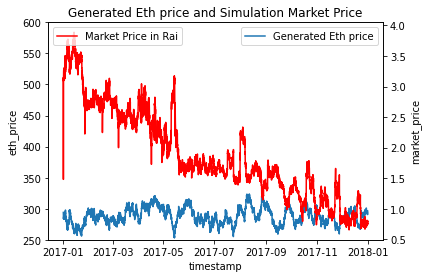

In [95]:
# eth_price, market_price (in eith), redemption rate (target_rate) 

# add table at top of notebook, provide term matching tables
# not a good system configuration

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline 
sns.lineplot(data=df,x="timestamp", y="eth_price",label='Generated Eth price')
plt.ylim(250, 600)
ax2 = plt.twinx()
sns.lineplot(data=df,x="timestamp", y="market_price",ax=ax2,color='r',label='Market Price in Rai')
plt.title('Generated Eth price and Simulation Market Price')
plt.legend(loc="upper left")
plt.show()

<AxesSubplot:xlabel='timestamp', ylabel='target_price'>

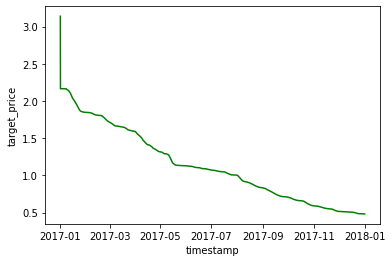

In [82]:
# in rai
sns.lineplot(data=df, x="timestamp", y="target_price",color='g')

In [89]:
df.plot(x='timestamp', y=['market_price', 'market_price_twap'])

In [90]:
df.plot(x='timestamp', y=['eth_price'], title='Historical ETH price')

In [61]:
df.plot(x='timestamp', y=['target_price', 'market_price', 'market_price_twap'], title='Target Price vs. Market Price')

In [62]:
df.plot(x='timestamp', y=['market_price', 'expected_market_price'], title='Expected Market Price')

In [63]:
df.plot(x='timestamp', y=['target_rate'], title='Controller Target Rate')

In [64]:
df['locked - freed - bitten'] = df['eth_locked'] - df['eth_freed'] - df['eth_bitten']
df.plot(y=['eth_collateral', 'locked - freed - bitten'], title='Debt Market Locked ETH Collateral')

In [65]:
df.plot(x='timestamp', y=['eth_collateral_value'], title='Debt Market Locked ETH Collateral Value ($)')

In [66]:
df.plot(x='timestamp', y=['eth_locked', 'eth_freed', 'eth_bitten'], title='Debt Market ETH State')

In [67]:
df['drawn - wiped - bitten'] = df['rai_drawn'] - df['rai_wiped'] - df['rai_bitten']
df.plot(x='timestamp', y=['principal_debt', 'drawn - wiped - bitten'], title='Debt Market RAI State')

In [68]:
df.plot(x='timestamp', y=['rai_drawn', 'rai_wiped', 'rai_bitten'], title='Debt Market RAI State')

In [69]:
df.plot(x='timestamp', y=['collateralization_ratio'], title='Collateralization Ratio')

In [70]:
df.plot(x='timestamp', y='RAI_balance', title='Uniswap RAI balance')

In [71]:
df.plot(x='timestamp', y='ETH_balance', title='Uniswap ETH balance')

In [72]:
df.plot(x='timestamp', y='UNI_supply', title='Uniswap UNI balance')

In [73]:
# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(x=df['timestamp'], y=df['target_price'], name="Target price"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=df['timestamp'], y=df['market_price_twap'], name="Market price TWAP"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=df['timestamp'], y=df['eth_price'], name="ETH price"),
    secondary_y=True,
)

# Add figure title
fig.update_layout(
    title_text="Market and Target Price vs. ETH Price"
)

# Set x-axis title
fig.update_xaxes(title_text="Timestamp")

# Set y-axes titles
fig.update_yaxes(title_text="Market and target price ($)", secondary_y=False)
fig.update_yaxes(title_text="ETH price ($)", secondary_y=True)

fig.update_layout(
    autosize=False,
    width=1000,
    margin=dict(
        l=50,
        r=50,
        b=100,
        t=100,
        pad=4
    ),
)

fig.show()

In [74]:

# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])
# Add traces
fig.add_trace(
    go.Scatter(x=df['timestamp'], y=df['target_price'], name="Redemption Price"),
    secondary_y=False,
)
fig.add_trace(
    go.Scatter(x=df['timestamp'], y=df['market_price_twap'], name="Market Price TWAP"),
    secondary_y=False,
)
fig.add_trace(
    go.Scatter(x=df['timestamp'], y=df['target_rate'], name="Redemption Rate"),
    secondary_y=True,
)
# Add figure title
fig.update_layout(
    title_text="Market Price, Redemption Price and Redemption Rate"
)
# Set x-axis title
fig.update_xaxes(title_text="Date")
# Set y-axes titles
fig.update_yaxes(title_text="Price (USD)", secondary_y=False)
fig.update_yaxes(title_text="Redemption Rate (1n = 1e-9)", secondary_y=True)

fig.update_layout(
    autosize=False,
    width=1000,
    margin=dict(
        l=50,
        r=50,
        b=100,
        t=100,
        pad=4
    ),
)

fig.show()

## Simulation statistics

In [75]:
std_mkt = df['market_price'].rolling(7).std()
std_mkt.plot()

In [76]:
np.std(df['market_price'])

0.7391628747867078

In [77]:
err_m_t = df['market_price'] - df['target_price']
err_m_t.plot()

In [78]:

df['market_price_rolling'] = df['market_price'].rolling(7).std()
fig = px.histogram(df, x="market_price_rolling", nbins=25)

fig.update_layout(
    title="7-Day Rolling Standard Deviation Histogram, Market Price (Controller On)",
    xaxis_title="Standard Deviation",
    yaxis_title="Frequency",
)

fig.show()